In [43]:
import os
import torch
import torchvision
from torch import nn, utils
from torchvision import transforms
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
import random
import os
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from torch.utils.data import random_split, DataLoader

import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models
from torchvision.models.resnet import ResNet18_Weights

# Exploring Dataset

In [44]:

BATCH_SIZE = 128
IMG_SIZE = 128

data_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(p=0.5)

])

class GarbageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
     
        self.root_dir = root_dir
        self.classes = os.listdir(root_dir) # each folder in root_dir is a class
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        self.transform = transform
        self.image_paths = []
        self.labels = []

        for cls in self.classes:
            cls_folder = os.path.join(root_dir, cls)
            for img_name in os.listdir(cls_folder):
                self.image_paths.append(os.path.join(cls_folder, img_name))
                self.labels.append(self.class_to_idx[cls])

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        image = Image.open(img_path).convert("RGB")  
        label = self.labels[idx]

        if self.transform:
            image = self.transform(image)

        return image, label

dataset = GarbageDataset(root_dir="Garbage Classification", transform=data_transform)

print("Dataset size:", len(dataset))
print("Number of classes:", len(dataset.classes))
print("Classes:", dataset.classes)
print("Class to index mapping:", dataset.class_to_idx)


train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15


total_size = len(dataset)
train_size = int(train_ratio * total_size)
val_size = int(val_ratio * total_size)
test_size = total_size - train_size - val_size  


train_set, val_set, test_set = random_split(dataset, [train_size, val_size, test_size])

train_loader = DataLoader(train_set, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_set, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=False)

print("\n")
print("Training set size:", len(train_set))
print("Validation set size:", len(val_set))
print("Test set size:", len(test_set))



Dataset size: 4650
Number of classes: 6
Classes: ['battery', 'glass', 'metal', 'organic', 'paper', 'plastic']
Class to index mapping: {'battery': 0, 'glass': 1, 'metal': 2, 'organic': 3, 'paper': 4, 'plastic': 5}


Training set size: 3255
Validation set size: 697
Test set size: 698


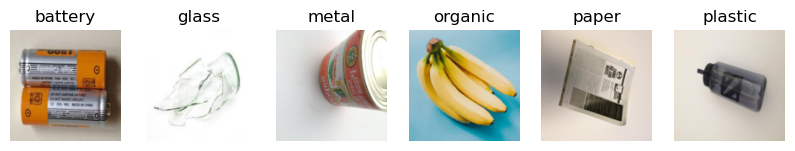

In [45]:
import matplotlib.pyplot as plt
import numpy as np

def show_sample_per_class(dataset):
    class_seen = set() 
    samples = []

    for image, label in dataset:
        if label not in class_seen:
            samples.append((image, label))
            class_seen.add(label)
        if len(class_seen) == len(dataset.classes):  
            break

    plt.figure(figsize=(10, 10))
    for i, (image, label) in enumerate(samples):
        image_np = image.permute(1, 2, 0).numpy().clip(0, 1)
        plt.subplot(1, len(samples), i + 1)
        plt.imshow(image_np)
        plt.title(dataset.classes[label])
        plt.axis("off")
    
    plt.show()


show_sample_per_class(dataset)

# Training Phase

Starting training...
Epoch 1/20, Training Loss: 0.6369, Training Accuracy: 0.7871
Epoch 1/20, Validation Loss: 0.4097, Validation Accuracy: 0.8666
Best model saved!
Epoch 2/20, Training Loss: 0.1568, Training Accuracy: 0.9475
Epoch 2/20, Validation Loss: 0.2056, Validation Accuracy: 0.9369
Best model saved!
Epoch 3/20, Training Loss: 0.0809, Training Accuracy: 0.9696
Epoch 3/20, Validation Loss: 0.2284, Validation Accuracy: 0.9498
Best model saved!
Epoch 4/20, Training Loss: 0.0861, Training Accuracy: 0.9748
Epoch 4/20, Validation Loss: 0.2224, Validation Accuracy: 0.9369
Epoch 5/20, Training Loss: 0.0730, Training Accuracy: 0.9751
Epoch 5/20, Validation Loss: 0.1810, Validation Accuracy: 0.9555
Best model saved!
Epoch 6/20, Training Loss: 0.0622, Training Accuracy: 0.9810
Epoch 6/20, Validation Loss: 0.1770, Validation Accuracy: 0.9570
Best model saved!
Epoch 7/20, Training Loss: 0.0422, Training Accuracy: 0.9859
Epoch 7/20, Validation Loss: 0.1938, Validation Accuracy: 0.9484
Epoch 8

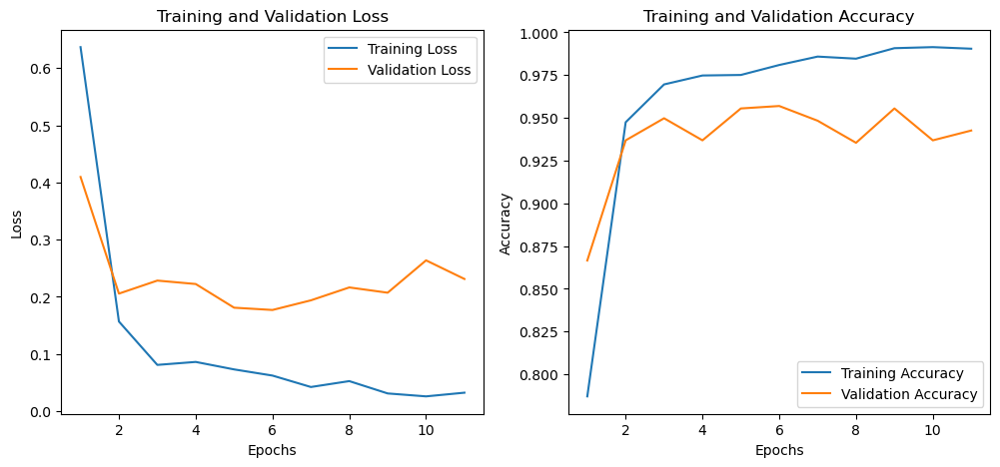

In [46]:
from torchvision import models
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from torchvision.models import EfficientNet_B0_Weights


model = models.efficientnet_b0(weights=EfficientNet_B0_Weights.IMAGENET1K_V1)

# Freeze the initial layers
for param in model.features[:3].parameters(): 
    param.requires_grad = False


num_classes = len(dataset.classes)
model.classifier = nn.Sequential(
    nn.Dropout(0.4),  
    nn.Linear(model.classifier[1].in_features, num_classes)
)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001)

early_stop_patience = 5
best_val_acc = 0.0
patience_counter = 0

print("Starting training...")

def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=10):
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []
    global best_val_acc, patience_counter

    for epoch in range(num_epochs):

        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()

            outputs = model(images)
            loss = criterion(outputs, labels)

            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

        train_loss = running_loss / len(train_loader.dataset)
        train_accuracy = correct / total
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)
        
        print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {train_loss:.4f}, Training Accuracy: {train_accuracy:.4f}")

        model.eval()
        val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                correct += (predicted == labels).sum().item()
                total += labels.size(0)

        val_loss /= len(val_loader.dataset)
        val_accuracy = correct / total
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f"Epoch {epoch+1}/{num_epochs}, Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}")

        if val_accuracy > best_val_acc:
            best_val_acc = val_accuracy
            patience_counter = 0
            torch.save(model.state_dict(), 'baseline.pth')
            print("Best model saved!")
        else:
            patience_counter += 1
            if patience_counter >= early_stop_patience:
                print("Early stopping triggered.")
                break

    return train_losses, val_losses, train_accuracies, val_accuracies

num_epochs = 20
train_losses, val_losses, train_accuracies, val_accuracies = train_model(
    model, train_loader, val_loader, criterion, optimizer, num_epochs=num_epochs
)

# Plot training and validation losses and accuracies
epochs = range(1, len(train_losses) + 1)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(epochs, train_losses, label="Training Loss")
plt.plot(epochs, val_losses, label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training and Validation Loss")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracies, label="Training Accuracy")
plt.plot(epochs, val_accuracies, label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Training and Validation Accuracy")
plt.legend()

plt.show()


# Basline Testing

In [47]:
model.load_state_dict(torch.load('baseline.pth'))

<All keys matched successfully>

Test Loss: 0.1657
Test Accuracy: 94.27%


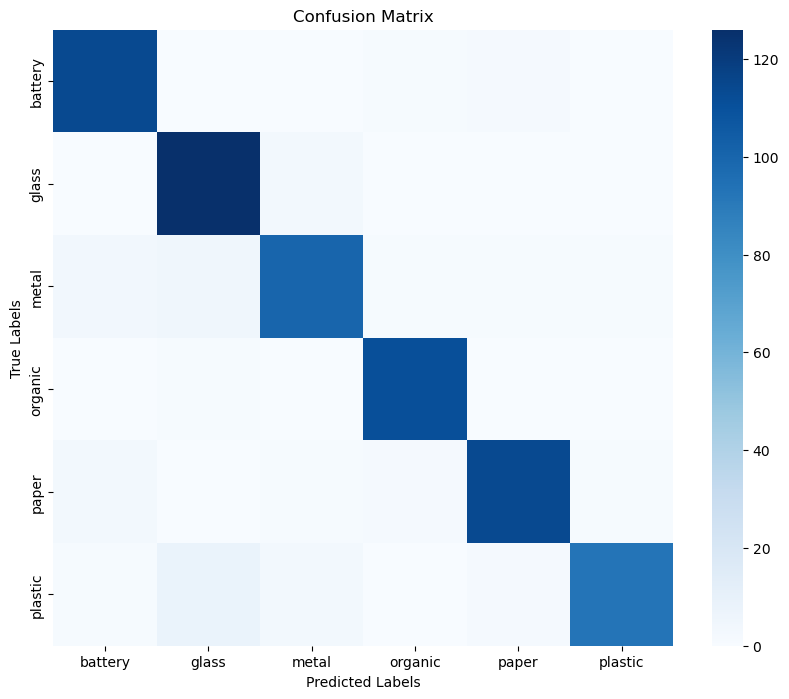

In [51]:
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Set the model to evaluation mode
model.eval()

test_loss = 0.0
correct = 0
total = 0

all_labels = []
all_predictions = []

# Disable gradient calculation for evaluation
with torch.no_grad():  
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)

        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()

        _, predicted = torch.max(outputs, 1)
        
        # Collect predictions and labels for the confusion matrix
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())
        
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

# Compute the average test loss and accuracy
test_loss /= len(test_loader)
test_accuracy = 100 * correct / total

print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.2f}%")

# Generate confusion matrix
cm = confusion_matrix(all_labels, all_predictions)
num_classes = len(dataset.classes)  # Adjust according to your dataset
class_names = dataset.classes  # Replace with your actual class names if available

# Plot the confusion matrix using seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=False, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()


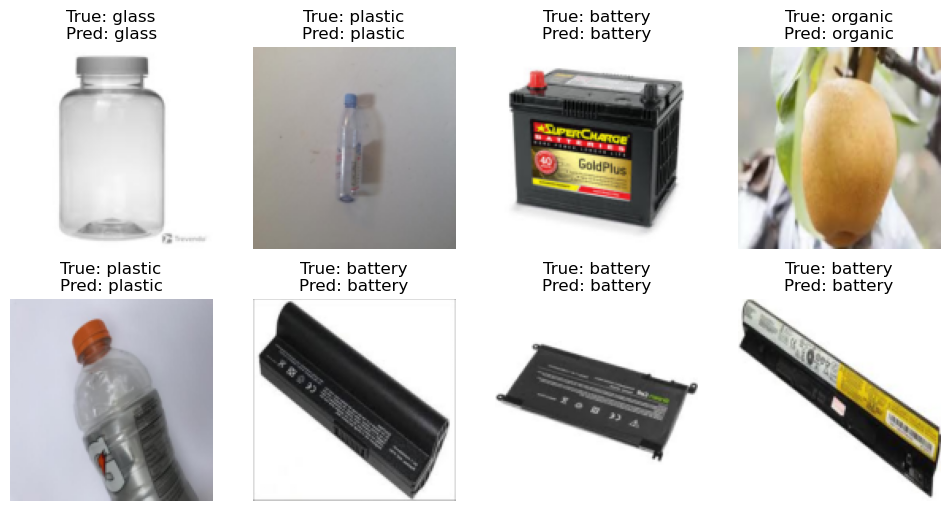

In [52]:
import matplotlib.pyplot as plt
import random

model.eval()

random_indices = random.sample(range(len(test_set)), BATCH_SIZE)
images, labels = zip(*[test_set[i] for i in random_indices]) 

images = torch.stack(images)
labels = torch.tensor(labels)

images, labels = images.to(device), labels.to(device)

with torch.no_grad():
    outputs = model(images)
    _, predictions = torch.max(outputs, 1)


num_samples = min(8, len(images)) 
plt.figure(figsize=(12, 6))
for i in range(num_samples):
    plt.subplot(2, 4, i + 1)
    image_np = images[i].cpu().permute(1, 2, 0).numpy().clip(0, 1)
    plt.imshow(image_np)
    plt.title(f"True: {dataset.classes[labels[i].item()]}\nPred: {dataset.classes[predictions[i].item()]}")
    plt.axis("off")

plt.show()


Processing images in class: Glass


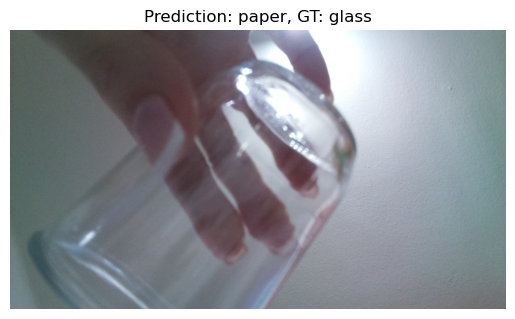

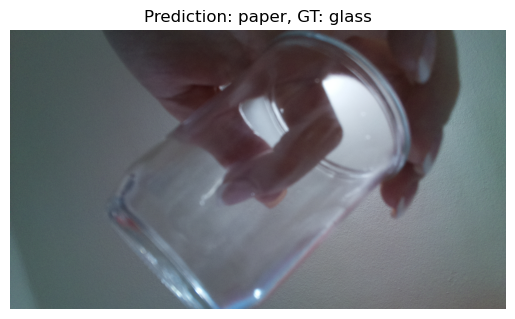

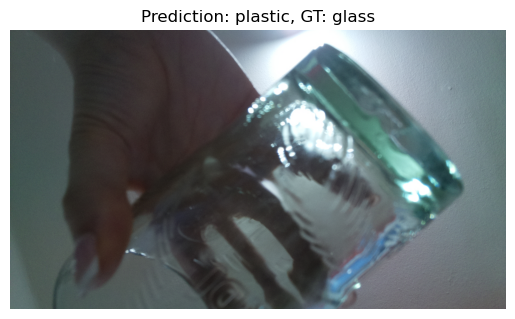

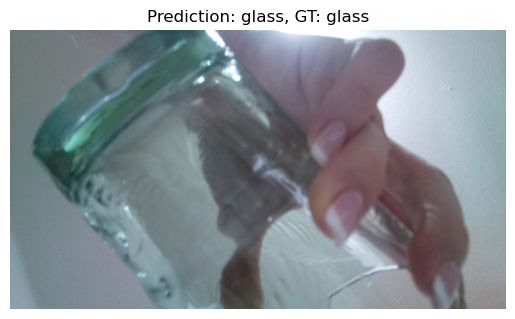

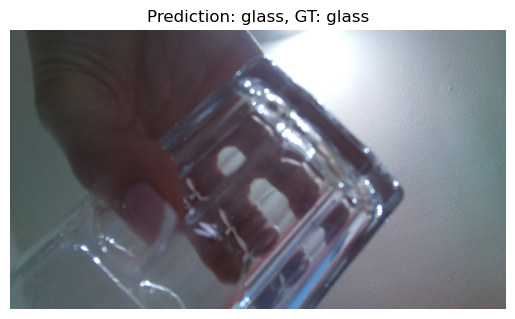

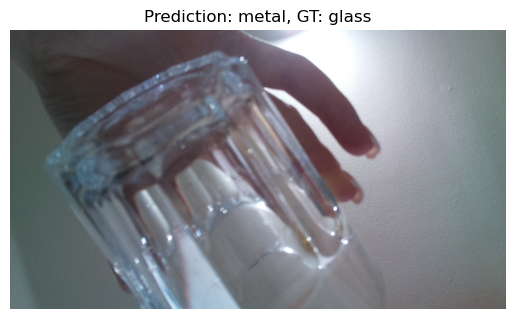

Processing images in class: Organic


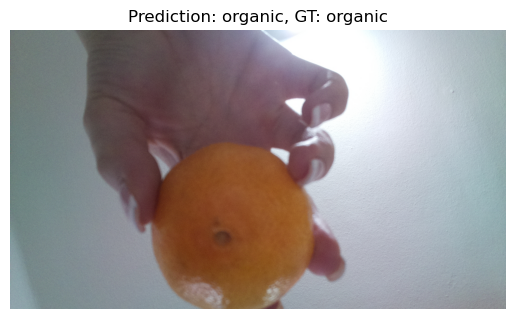

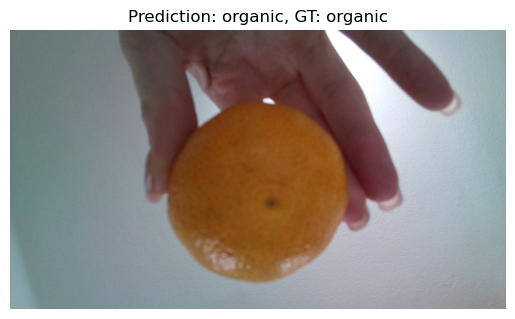

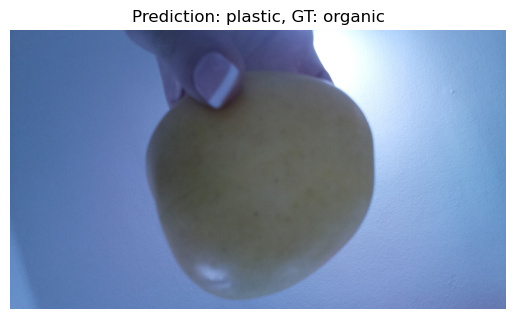

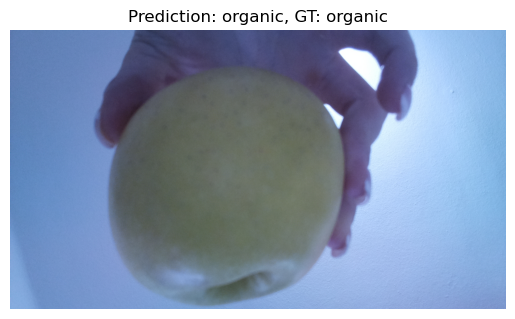

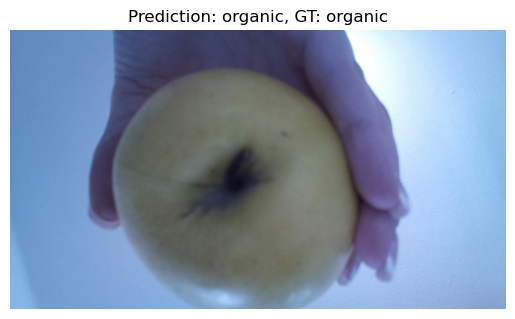

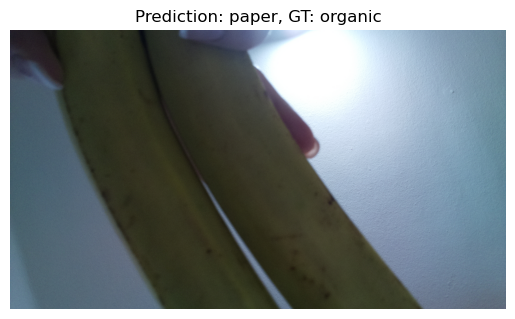

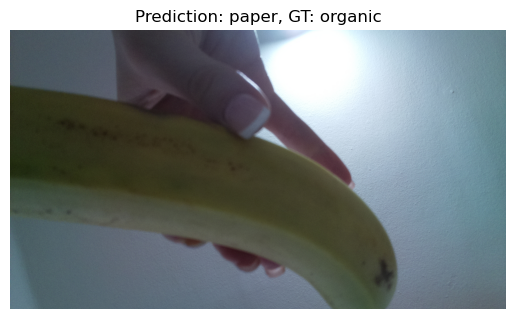

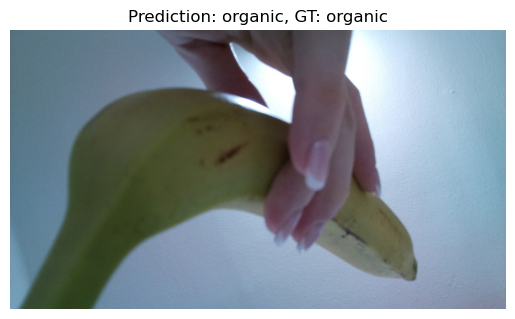

Processing images in class: Paper


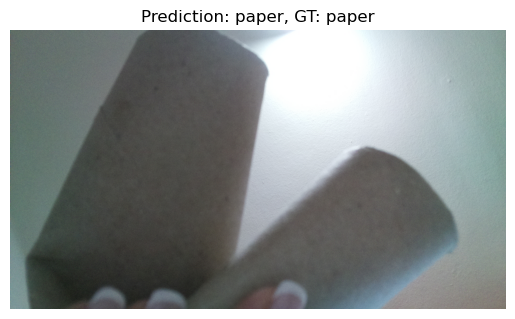

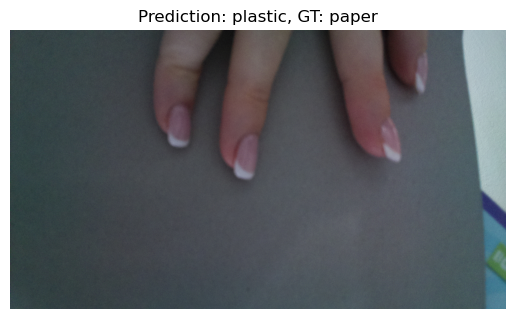

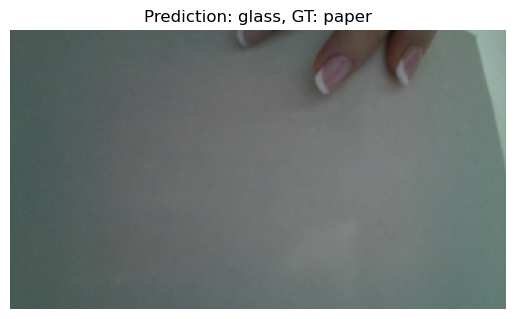

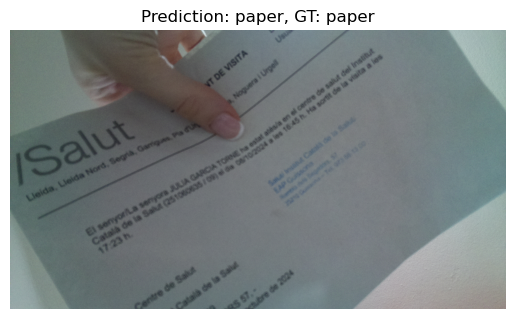

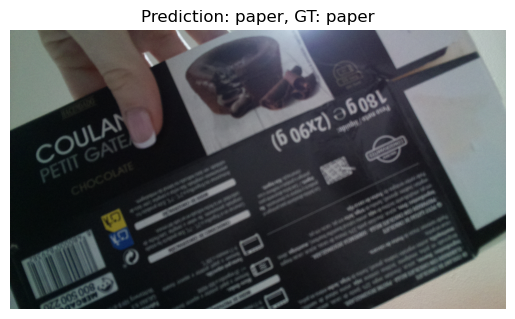

...

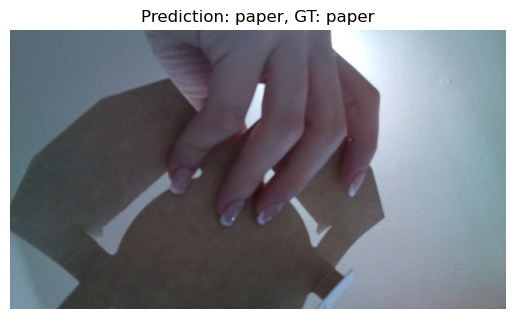

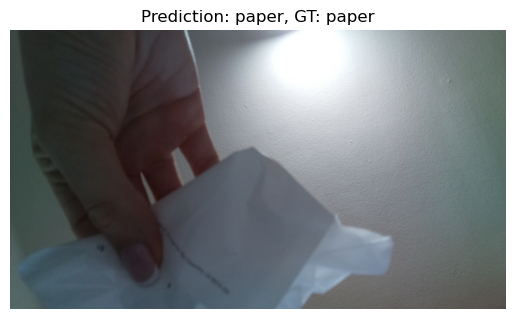

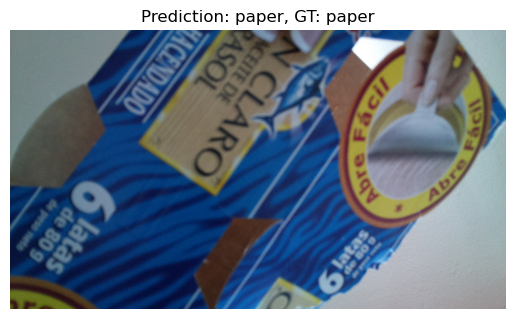

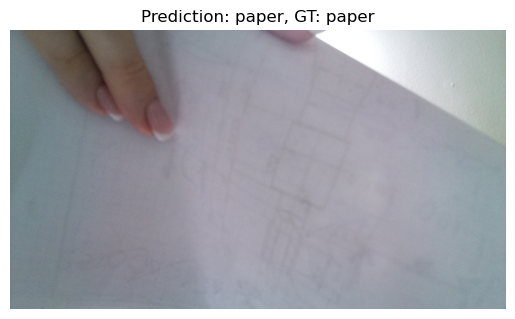

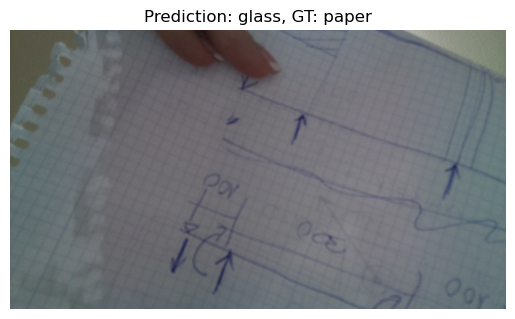

Processing images in class: Plastic


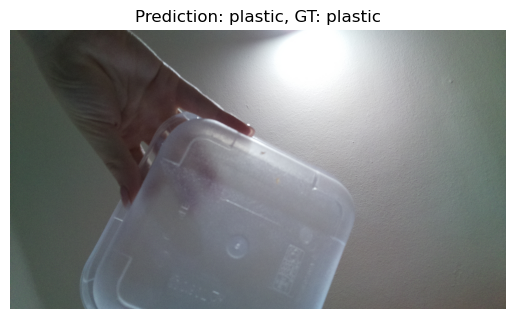

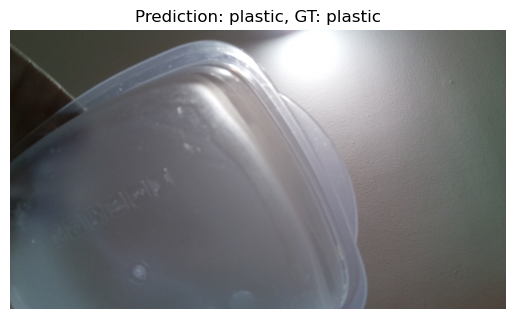

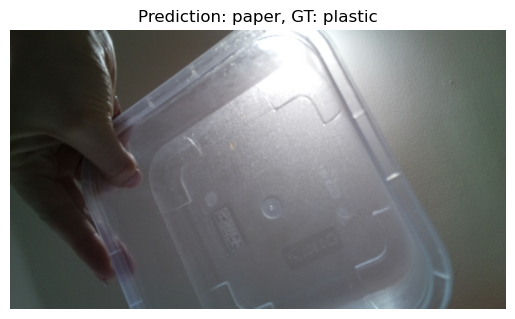

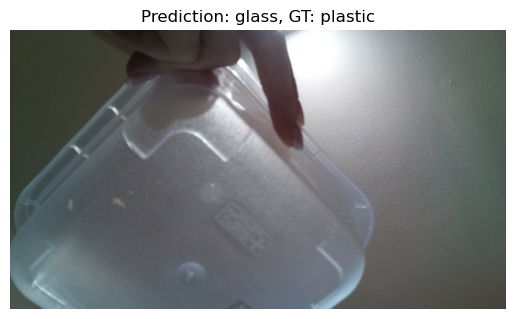

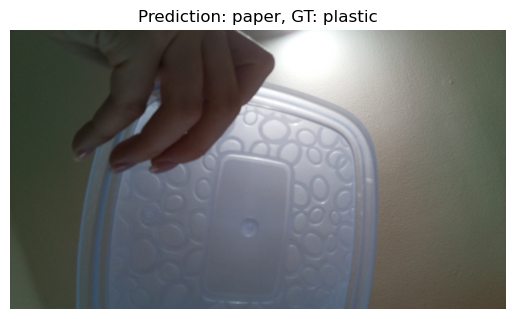

...

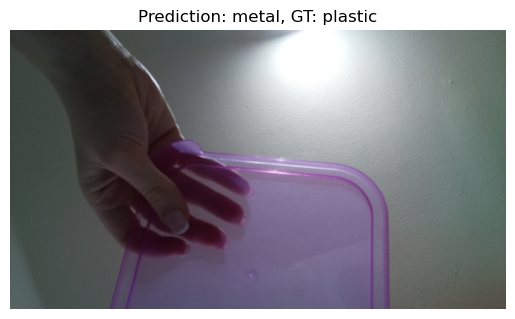

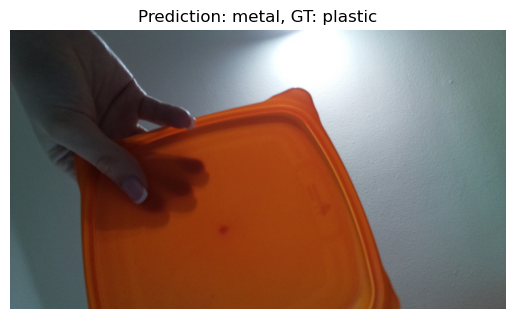

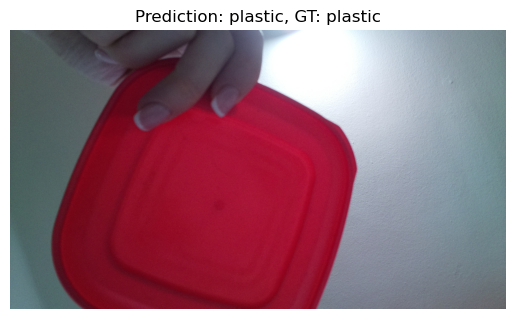

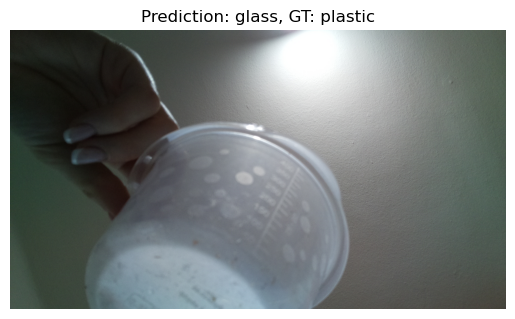

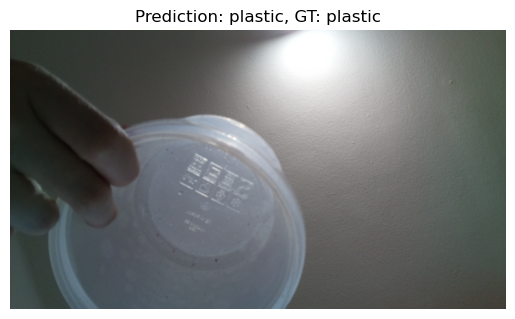

Accuracy: 58.00%


In [53]:
import os
from PIL import Image
import torch
import torch.nn as nn
from torchvision import transforms, models
import matplotlib.pyplot as plt
from torchvision.models import EfficientNet_B0_Weights

# Set up the device and model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = models.efficientnet_b0(weights=EfficientNet_B0_Weights.IMAGENET1K_V1)
model.classifier = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(model.classifier[1].in_features, 6)  # Adjusted for 6 classes
)

# Load your trained model weights
model.load_state_dict(torch.load('baseline.pth'))
model = model.to(device)
model.eval()

# Define the transformation
data_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor()
])


# Directory containing the dataset
dataset_dir = r"C:\Users\User\OneDrive\Escritorio\AI Garbage Classification\Custom Dataset"


true = []
pred = []

# Iterate through each class folder
for class_name in os.listdir(dataset_dir):
    class_dir = os.path.join(dataset_dir, class_name)
    
    # Skip if it's not a directory
    if not os.path.isdir(class_dir):
        continue
    
    print(f"Processing images in class: {class_name}")
    
    # Iterate through each image in the class folder
    for img_name in os.listdir(class_dir):
        img_path = os.path.join(class_dir, img_name)
        
        # Open and preprocess the image
        image = Image.open(img_path).convert("RGB")
        image = data_transform(image).unsqueeze(0).to(device)
        
        # Perform inference
        with torch.no_grad():
            output = model(image)
            _, prediction = torch.max(output, 1)

        true.append(class_name.lower())
        pred.append(dataset.classes[prediction])
    
        plt.imshow(plt.imread(img_path))
        plt.title(f"Prediction: {dataset.classes[prediction]}, GT: {class_name.lower()}")
        plt.axis("off")
        plt.show()


# Compute accuracy

correct = sum([1 for t, p in zip(true, pred) if t == p])
accuracy = correct / len(true) * 100

print(f"Accuracy: {accuracy:.2f}%")

# Domain Adaptation

Starting training...
Epoch 1/20, Training Loss: 0.9508, Training Accuracy: 0.3754
Epoch 1/20, Validation Loss: 1.6342, Validation Accuracy: 0.4275
Best model saved!
Epoch 2/20, Training Loss: 0.2815, Training Accuracy: 0.5646
Epoch 2/20, Validation Loss: 1.3427, Validation Accuracy: 0.4577
Best model saved!
Epoch 3/20, Training Loss: 0.2090, Training Accuracy: 0.6954
Epoch 3/20, Validation Loss: 1.4020, Validation Accuracy: 0.4792
Best model saved!
Epoch 4/20, Training Loss: 0.1688, Training Accuracy: 0.7708
Epoch 4/20, Validation Loss: 1.2990, Validation Accuracy: 0.5352
Best model saved!
Epoch 5/20, Training Loss: 0.1581, Training Accuracy: 0.7923
Epoch 5/20, Validation Loss: 1.1324, Validation Accuracy: 0.5796
Best model saved!
Epoch 6/20, Training Loss: 0.1336, Training Accuracy: 0.8369
Epoch 6/20, Validation Loss: 1.0496, Validation Accuracy: 0.6700
Best model saved!
Epoch 7/20, Training Loss: 0.1216, Training Accuracy: 0.8400
Epoch 7/20, Validation Loss: 1.0178, Validation Accura

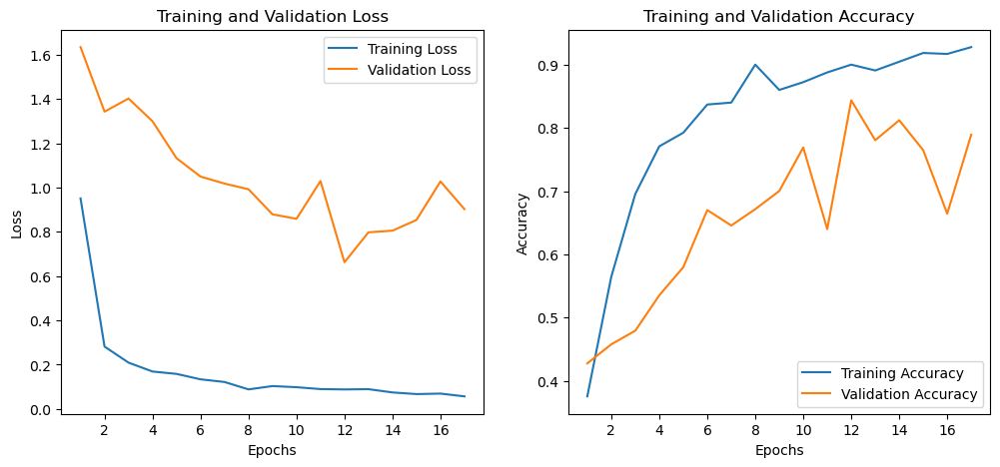

In [54]:
from torchvision import models
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from torchvision.models import EfficientNet_B0_Weights
from torch.utils.data import DataLoader

BATCH_SIZE = 32

custom_dataset = GarbageDataset(root_dir="Custom Dataset", transform=data_transform)
custom_loader = DataLoader(custom_dataset, batch_size=BATCH_SIZE, shuffle=False)

model = models.efficientnet_b0(weights=EfficientNet_B0_Weights.IMAGENET1K_V1)

# Freeze the initial layers
for param in model.features[:3].parameters(): 
    param.requires_grad = False

num_classes = len(dataset.classes)
# Separate backbone and classifier head
backbone = model.features
classifier = nn.Sequential(
    nn.Dropout(0.4),  
    nn.Linear(model.classifier[1].in_features, num_classes)
)
model.classifier = classifier

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
backbone, classifier = backbone.to(device), classifier.to(device)

criterion = nn.CrossEntropyLoss()
similarity_criterion = nn.KLDivLoss(reduction='batchmean')
optimizer = optim.Adam(
    list(backbone.parameters()) + list(classifier.parameters()), 
    lr=0.001
)

early_stop_patience = 5
best_val_acc = 0.0
patience_counter = 0

print("Starting training...")

def train_model(backbone, classifier, train_loader, val_loader, custom_loader, criterion, similarity_criterion, optimizer, num_epochs=10):
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    global best_val_acc, patience_counter

    for epoch in range(num_epochs):

        backbone.train()
        classifier.train()
        running_loss = 0.0
        correct = 0
        total = 0
        
        custom_iter = iter(custom_loader) 
        
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            
            try:
                custom_images, _ = next(custom_iter)
            except StopIteration:
                custom_iter = iter(custom_loader)
                custom_images, _ = next(custom_iter)

            custom_images = custom_images.to(device)
            
            # truncate larger batch to match the smaller batch size

            min_batch_size = min(images.size(0), custom_images.size(0))
            images, labels = images[:min_batch_size], labels[:min_batch_size]
            custom_images = custom_images[:min_batch_size]
            
           
            za = backbone(images)  
            zb = backbone(custom_images) 

           
            outputs = classifier(za.mean([2, 3])) 
            
        
            ce_loss = criterion(outputs, labels)

            za_softmax = nn.functional.log_softmax(za, dim=1) 
            zb_softmax = nn.functional.softmax(zb, dim=1)     

            kl_loss = similarity_criterion(za_softmax, zb_softmax)

            alpha = 0.2
            loss = ce_loss + alpha * kl_loss

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

        train_loss = running_loss / len(train_loader.dataset)
        train_accuracy = correct / total
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)
        
        print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {train_loss:.4f}, Training Accuracy: {train_accuracy:.4f}")

        backbone.eval()
        classifier.eval()
        val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                za = backbone(images)
                outputs = classifier(za.mean([2, 3]))  # Average pooling or flatten
                
                loss = criterion(outputs, labels)
                val_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                correct += (predicted == labels).sum().item()
                total += labels.size(0)

        val_loss /= len(val_loader.dataset)
        val_accuracy = correct / total
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f"Epoch {epoch+1}/{num_epochs}, Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}")

        if val_accuracy > best_val_acc:
            best_val_acc = val_accuracy
            patience_counter = 0
            torch.save(model.state_dict(), 'domain_adaptation.pth')
            print("Best model saved!")
        else:
            patience_counter += 1
            if patience_counter >= early_stop_patience:
                print("Early stopping triggered.")
                break

    return train_losses, val_losses, train_accuracies, val_accuracies


num_epochs = 20
train_losses, val_losses, train_accuracies, val_accuracies = train_model(
    backbone, classifier, train_loader, val_loader, custom_loader, criterion, similarity_criterion, optimizer, num_epochs=num_epochs
)

# Plot training and validation losses and accuracies
epochs = range(1, len(train_losses) + 1)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(epochs, train_losses, label="Training Loss")
plt.plot(epochs, val_losses, label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training and Validation Loss")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracies, label="Training Accuracy")
plt.plot(epochs, val_accuracies, label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Training and Validation Accuracy")
plt.legend()

plt.show()


Test Loss: 0.6617
Test Accuracy: 83.67%


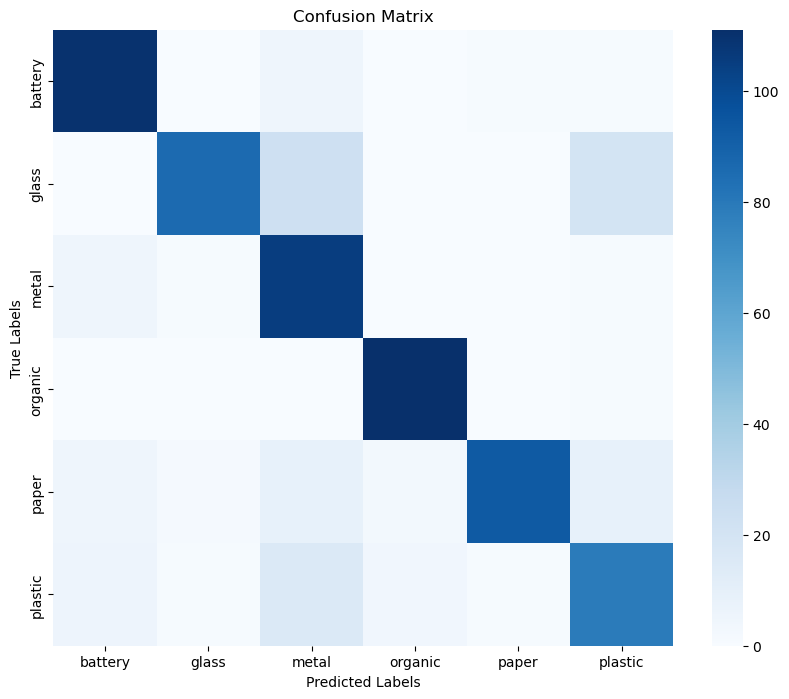

In [55]:
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

model.load_state_dict(torch.load('domain_adaptation.pth'))

# Set the model to evaluation mode
model.eval()

test_loss = 0.0
correct = 0
total = 0

all_labels = []
all_predictions = []

# Disable gradient calculation for evaluation
with torch.no_grad():  
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)

        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()

        _, predicted = torch.max(outputs, 1)
        
        # Collect predictions and labels for the confusion matrix
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())
        
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

# Compute the average test loss and accuracy
test_loss /= len(test_loader)
test_accuracy = 100 * correct / total

print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.2f}%")

# Generate confusion matrix
cm = confusion_matrix(all_labels, all_predictions)
num_classes = len(dataset.classes)  # Adjust according to your dataset
class_names = dataset.classes  # Replace with your actual class names if available

# Plot the confusion matrix using seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=False, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix")
plt.show()


Processing images in class: Glass


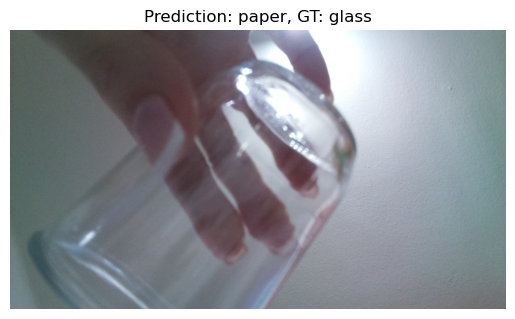

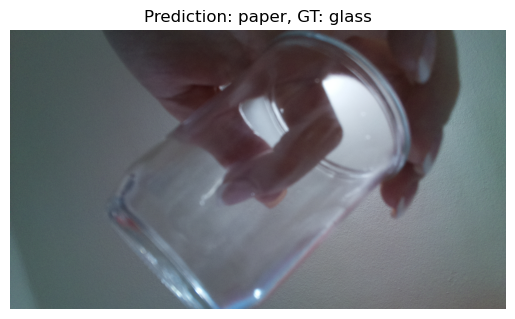

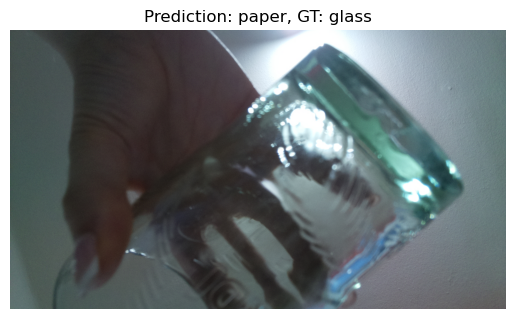

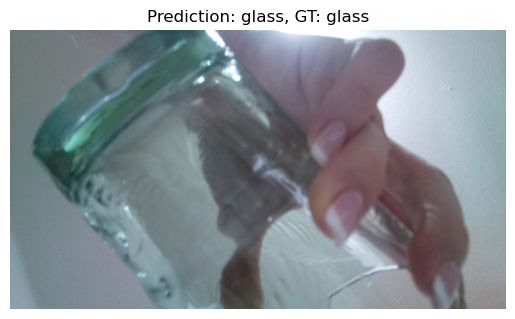

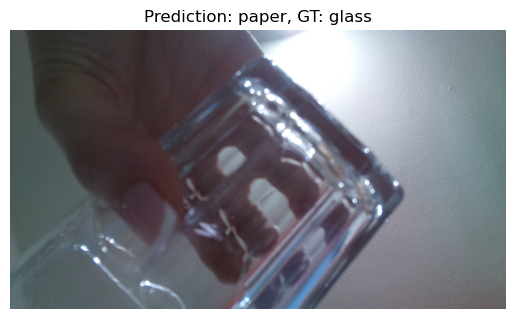

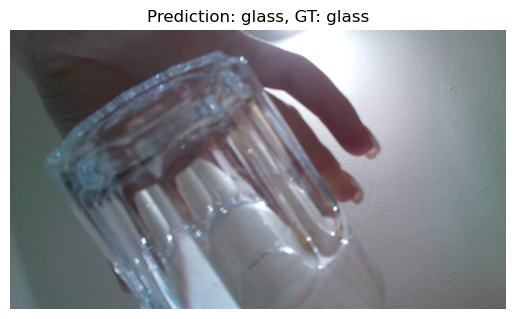

Processing images in class: Organic


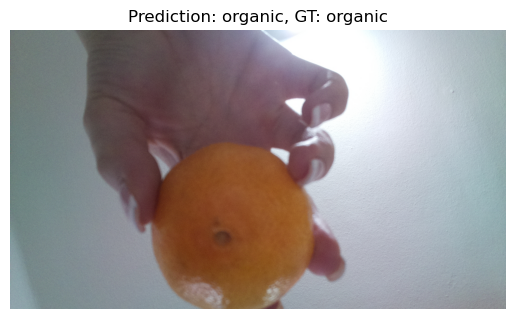

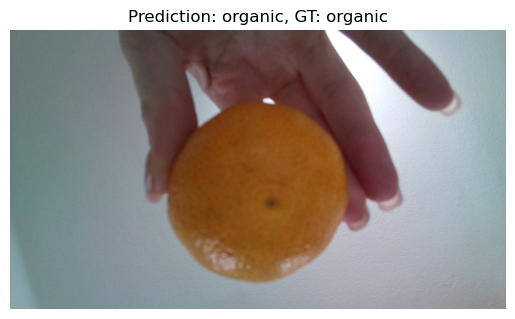

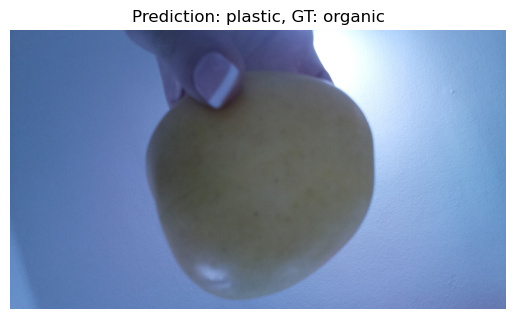

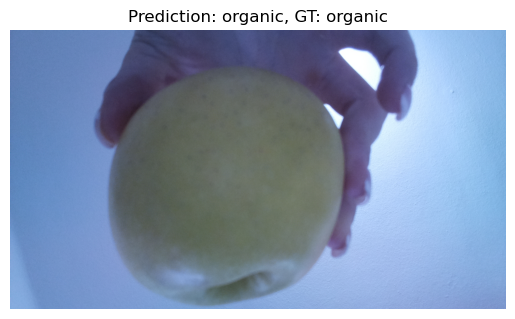

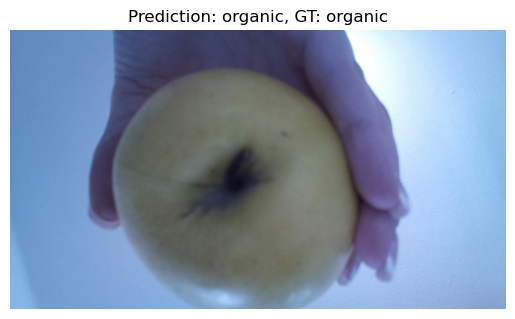

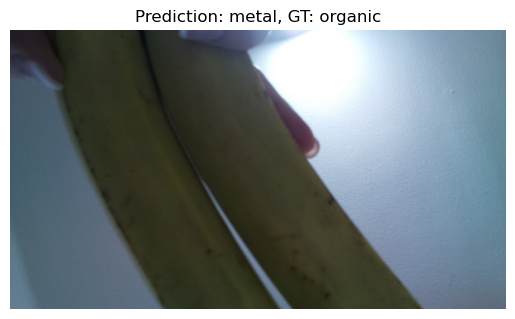

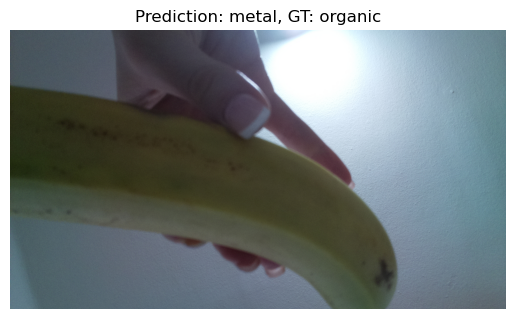

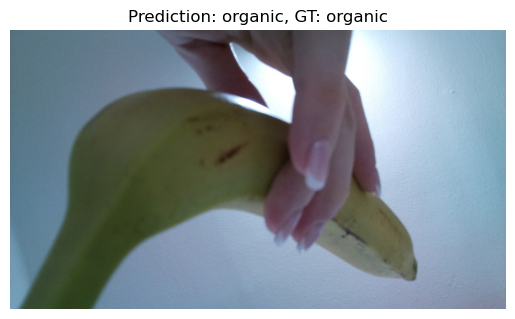

Processing images in class: Paper


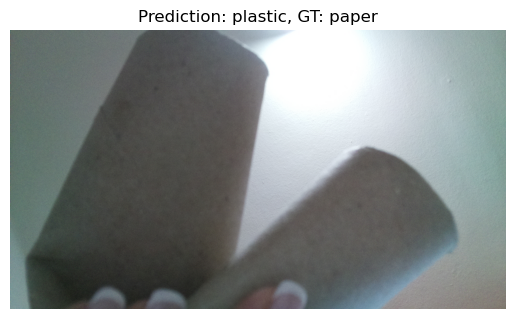

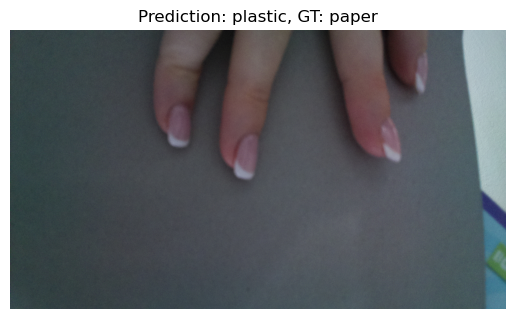

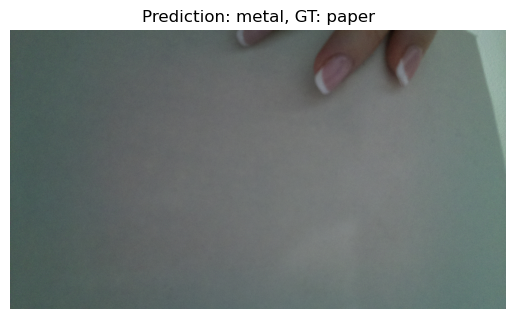

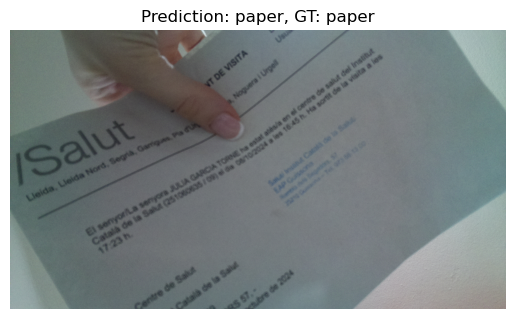

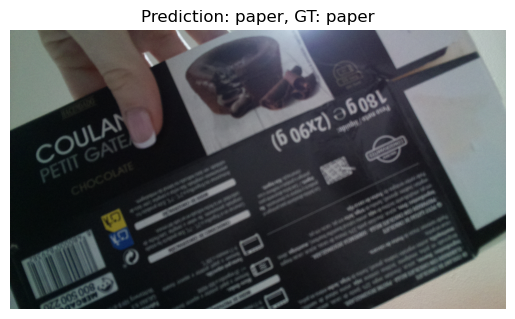

...

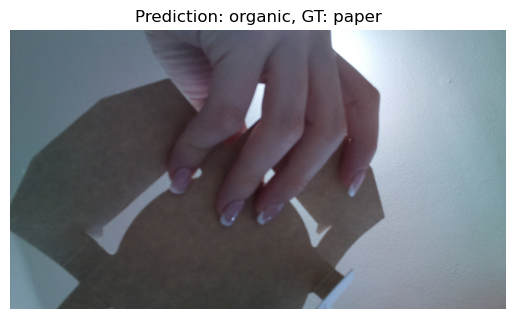

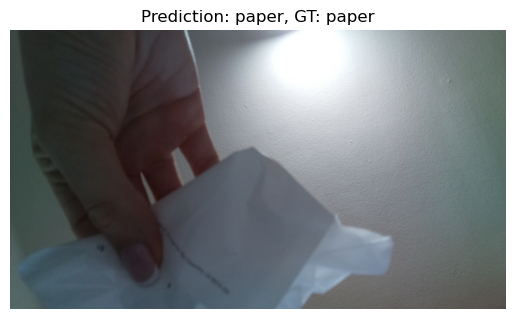

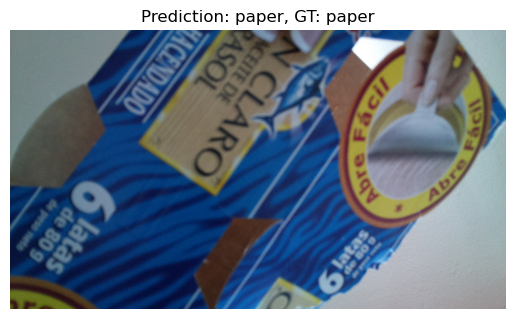

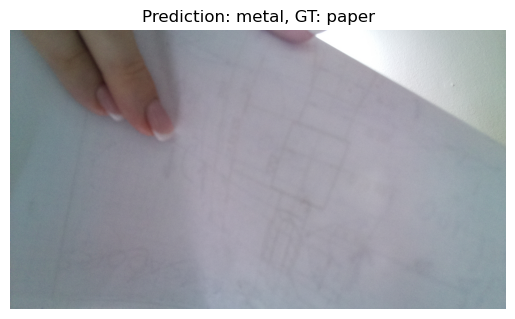

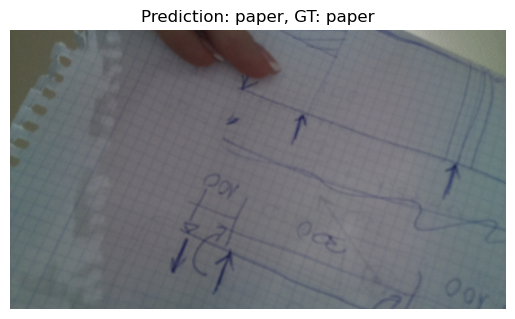

Processing images in class: Plastic


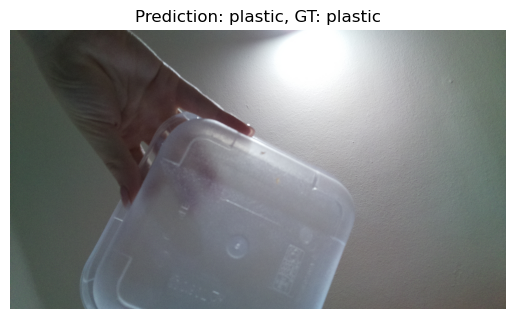

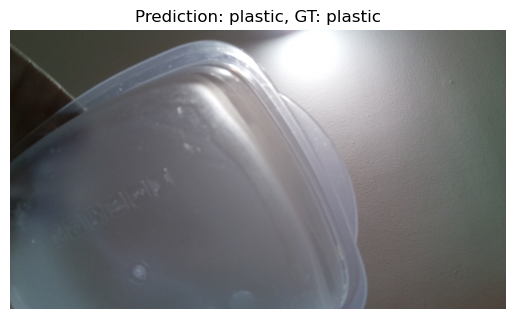

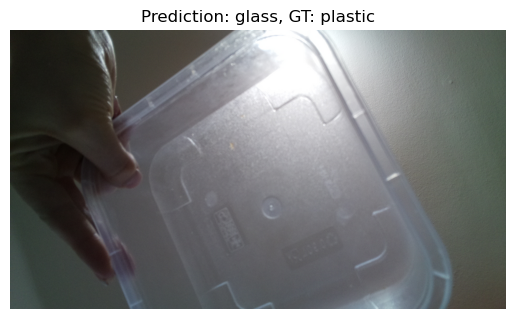

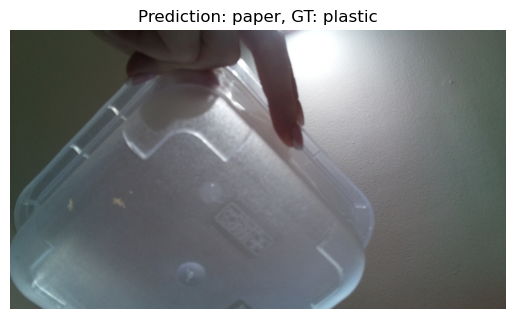

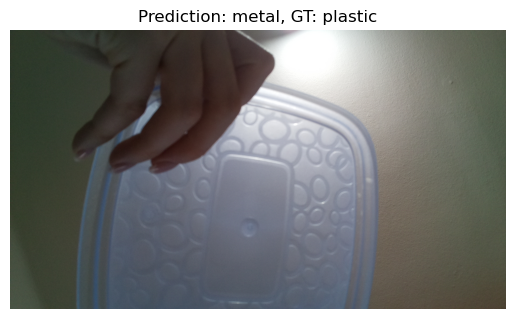

...

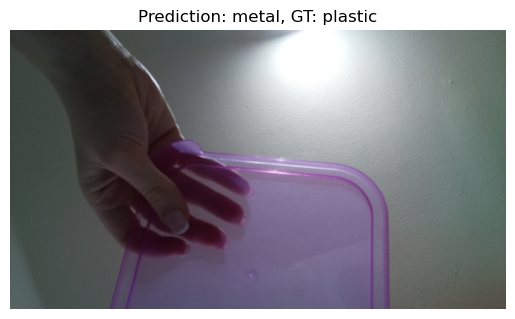

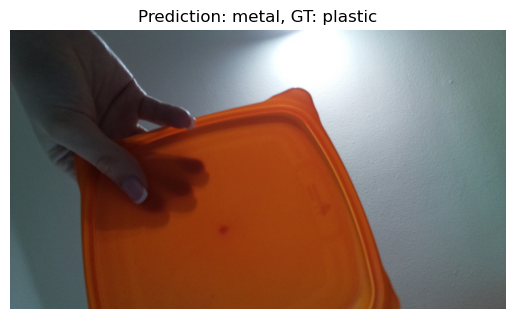

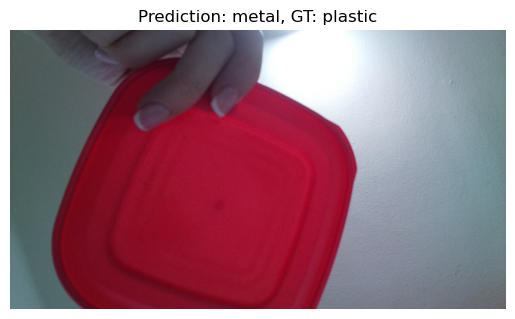

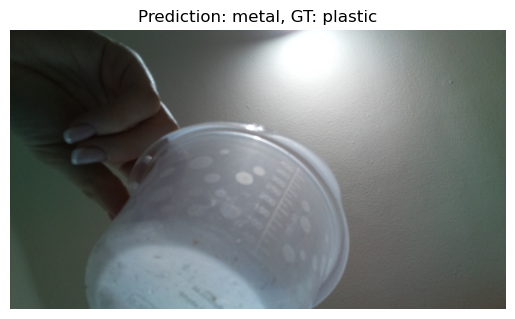

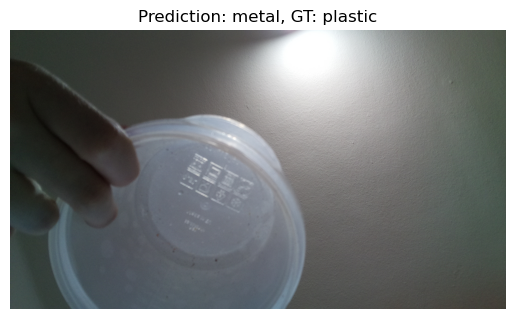

Accuracy: 46.00%


In [56]:
import os
from PIL import Image
import torch
import torch.nn as nn
from torchvision import transforms, models
import matplotlib.pyplot as plt
from torchvision.models import EfficientNet_B0_Weights

# Set up the device and model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = models.efficientnet_b0(weights=EfficientNet_B0_Weights.IMAGENET1K_V1)
model.classifier = nn.Sequential(
    nn.Dropout(0.4),
    nn.Linear(model.classifier[1].in_features, 6)  # Adjusted for 6 classes
)

# Load your trained model weights
model.load_state_dict(torch.load('domain_adaptation.pth'))
model = model.to(device)
model.eval()

# Define the transformation
data_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor()
])


# Directory containing the dataset
dataset_dir = r"C:\Users\User\OneDrive\Escritorio\AI Garbage Classification\Custom Dataset"


true = []
pred = []

# Iterate through each class folder
for class_name in os.listdir(dataset_dir):
    class_dir = os.path.join(dataset_dir, class_name)
    
    # Skip if it's not a directory
    if not os.path.isdir(class_dir):
        continue
    
    print(f"Processing images in class: {class_name}")
    
    # Iterate through each image in the class folder
    for img_name in os.listdir(class_dir):
        img_path = os.path.join(class_dir, img_name)
        
        # Open and preprocess the image
        image = Image.open(img_path).convert("RGB")
        image = data_transform(image).unsqueeze(0).to(device)
        
        # Perform inference
        with torch.no_grad():
            output = model(image)
            _, prediction = torch.max(output, 1)

        true.append(class_name.lower())
        pred.append(dataset.classes[prediction])
    
        plt.imshow(plt.imread(img_path))
        plt.title(f"Prediction: {dataset.classes[prediction]}, GT: {class_name.lower()}")
        plt.axis("off")
        plt.show()


# Compute accuracy

correct = sum([1 for t, p in zip(true, pred) if t == p])
accuracy = correct / len(true) * 100

print(f"Accuracy: {accuracy:.2f}%")